## From vibrations of crystals with 1D diatomic structure to a creative sonic frequency selector
<br>

**Marc Castell Borrell (22738285)**

10/11/2025

# 1. Calculation of dispersion relation

In this section, we visualise the phonon dispersion relation for a 1D diatomic crystal, which describes how vibrations can travel through the lattice. We present an interactive plot of the first Brillouin zone that demonstrates how the dispersion curves change as we change the masses or the spring constant K. The solutions derive from the model of two masses connected by a spring and are found by solving the following equation:

$$
\omega^4 - 2K\left(\frac{m_1+m_2}{m_1 m_2}\right)\omega^2 + \frac{4K^2}{m_1 m_2}\sin^2\left(\frac{ka}{2}\right) = 0
$$

Solving this for the frequency $\omega$ gives two solutions for every wavevector $k$: a low-frequency Acoustic Branch and a high-frequency Optical Branch.

The plot shows how these branches, and the frequency band gap between them, change as you adjust the parameters.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, FloatSlider
from scipy.io import wavfile
from scipy.fft import rfft, irfft, rfftfreq
from IPython.display import Audio, display

In [ ]:
# Define dispersion relation calculation function
def dispersion_relation(K, m1, m2):
    # Create k-values array from -π to π with 2000 points full first Brillouin zone
    k_array = np.linspace(-np.pi, np.pi, 2000)
    
    # Normalized lattice constant (distance between unit cells)
    a = 1.0
    
    # arrays for angular frequencies squared
    omega_sq_ac = np.zeros(2000)
    omega_sq_op = np.zeros(2000)
    
    # Solve the dispersion relation:
    # A*w^4 + B*w^2 + C = 0, where we solve for w^2
    
    # Coefficients for quadratic equation:
    A = 1.0
    B = -2 * K * (m1 + m2) / (m1 * m2)
    
    #find C for different k values
    for i in range(len(k_array)):
        k = k_array[i]
        C = 4 * K**2 / (m1 * m2) * np.sin(k * a / 2)**2

        # Solve for w^2 using quadratic formula:
        # Acoustic, lower frequencies, minus sign solution
        omega_sq_ac[i] = (-B - np.sqrt(B**2 - 4 * A * C)) / (2 * A)

        # Optical, higher frequencies, plus sign solution
        omega_sq_op[i] = (-B + np.sqrt(B**2 - 4 * A * C)) / (2 * A)
    
    # Convert to angular frequency w
    omega_ac = np.sqrt(np.abs(omega_sq_ac))
    omega_op = np.sqrt(np.abs(omega_sq_op))
    
    # Convert omega to frequency: f = w/(2*pi)
    # If w in rad/s, f has unit Hz
    f_ac = omega_ac / (2 * np.pi)
    f_op = omega_op / (2 * np.pi)
    
    # Calculate band gap
    # Band gap exists between max of acoustic branch and min of optical branch
    band_gap_bot = np.max(f_ac)
    band_gap_top = np.min(f_op)
    band_gap_width = band_gap_top - band_gap_bot
    
    return k_array, f_ac, f_op, band_gap_bot, band_gap_top, band_gap_width


In [ ]:
# dispersion plot with interactive values

def plot_dispersion(K=200, m1=2.0, m2=1.0):
    #atomic masses would be of the order of amu's, 
    #but for easier calculations we don't convert them yet as we only care about ratios
    #masses in atomic mass units
    #amu_kg = 1.660539e-27  # 1 amu in kg
    #m1 = m1_amu * amu_kg
    #m2 = m2_amu * amu_kg

    k_array, f_ac, f_op, band_gap_bot, band_gap_top, band_gap_width = dispersion_relation(K, m1, m2)
    
    # Create the plot
    plt.figure(figsize=(10, 6))
    
    #kmax = pi/a in first brillouin zone. a=1, so k_array/pi gives k/k_kmax ratio
    plt.plot(k_array / np.pi, f_ac, 'b-', linewidth=2, label='Acoustic Branch') #acoustic branch
    
    plt.plot(k_array / np.pi, f_op, 'r-', linewidth=2, label='Optical Branch') #optical branch
    
    # Yellow region filling the band gap region in the plot. alpha value defines opacity of colour
    plt.axhspan(band_gap_bot, band_gap_top, alpha=0.3, color='yellow', label='Band Gap')
    
    # Labels and formatting
    plt.xlabel('k/k_max', fontsize=12)  
    plt.ylabel('Frequency (Hz)', fontsize=12)
    plt.title(f'Phonon Dispersion Relations for 1D Diatomic Chain\nK={K}, m₁={m1}, m₂={m2}', fontsize=14)
    plt.legend(loc='best', fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.xlim(-1, 1)  # Full Brillouin zone from -pi topi
    plt.tight_layout()
    plt.show()
    
    # Print band gap information
    print(f"\n{'='*50}")
    print(f"Band Gap:")
    print(f"Bottom Frequency (max acoustic): {band_gap_bot:.2f}")
    print(f"Top Frequency (min optical):     {band_gap_top:.2f}")
    print(f"Gap Width:                       {band_gap_width:.2f}")
    print(f"Mass Ratio (m2/m1):              {m2/m1:.2f}")
    
    print(f"\n{'='*50}")
    print(f"Maximum Optical Frequency: {np.max(f_op):.2f}")
    
    


#interactive sliders for K (spring constant) and m1,m2
interact(plot_dispersion,K=FloatSlider(min=200, max=2000, step=100, value=200, description='K (N/m):'),m1=FloatSlider(min=1.0, max=5.0, step=0.1, value=2.0, description='m₁:'),m2=FloatSlider(min=1.0, max=5.0, step=0.1, value=1.0, description='m₂:'));

interactive(children=(FloatSlider(value=500.0, description='K (N/m):', max=2000.0, min=200.0, step=100.0), Flo…

<div style="text-align: center;">
  <div style="display: flex; gap: 20px; justify-content: center;">
    <img src="nogap.png" width="400">
    <img src="biggap.png" width="400">
  </div>
  <p>img.1: m1=m2=2.0 /  img.2: m1=1.0, m2=5.0</p>
  <p>No gap if masses are the same. The bigger the difference between masses, the bigger the gap</p>
</div>

# 2. 1D diatomic structure as a sound frequency filter

The appearance of the frequency gap in the dispersion relation means that no vibrations with the frequency values lying inside the gap or above the dispersion relation can propagate through the crystal structure. We know that sound is an acoustic vibration that propagates through a medium. If sound waves were transmitted through our lattice, we could purposely block certain frequencies by choosing appropriate values for the diatomic structure so that the frequency gap lies in the audible spectrum. Then, our crystal would act as a sonic filter.


However, in real crystals the band gap frequencies can be in the THz range, far higher than audible sound (20Hz-20kHz). So, in order to show the frequency filtering effect for audible frequencies, we first need to creatively scale the parameters of our model so that the resulting band gap appears in the desired frequency range. 

We find that the values of the masses required are immense compared to that of atoms, so technically our model won't be a diatomic crystal anymore. But the spring-mass chain structure will be analogous to that of diatomic 1D crystals and we will assume that the vibrations will behave in a similar way (as our only goal is to show through an example which frequencies are transmitted and which not).

Assume the diatomic chain is sufficiently long to allow for total damping of the non-propagated frequencies. Sound wave is transmitted to the crystal without impedance, meaning that all the vibrational energy is transmitted to the crystal. Then, we would expect the frequencies in the acoustic branch to be fully transmitted, the frequencies within the gap fully blocked, and the frequencies in the optical branch transmitted too. However, in the optical branch the motion is out-of-phase, which couples less efficiently with the uniform in-phase sound wave, resulting in a damping of the transmitted amplitude.

- - -
<br>
First we want to find values for the parameters such that the frequency gap is in the audible range (20Hz-20kHz), we chose 1000Hz-3000Hz. Wavelike solutions don't exist between $\omega = (2K/M_1)^{1/2}$ and $\omega = (2K/M_2)^{1/2}$. We make a reasonable assumption for the spring constant $K$ to find $M_1$ and $M_2$ knowing that $f = \frac{\omega}{2\pi}$



K = 1.000e+04 N/m
m1 = 0.000056 kg
m2 = 0.000507 kg


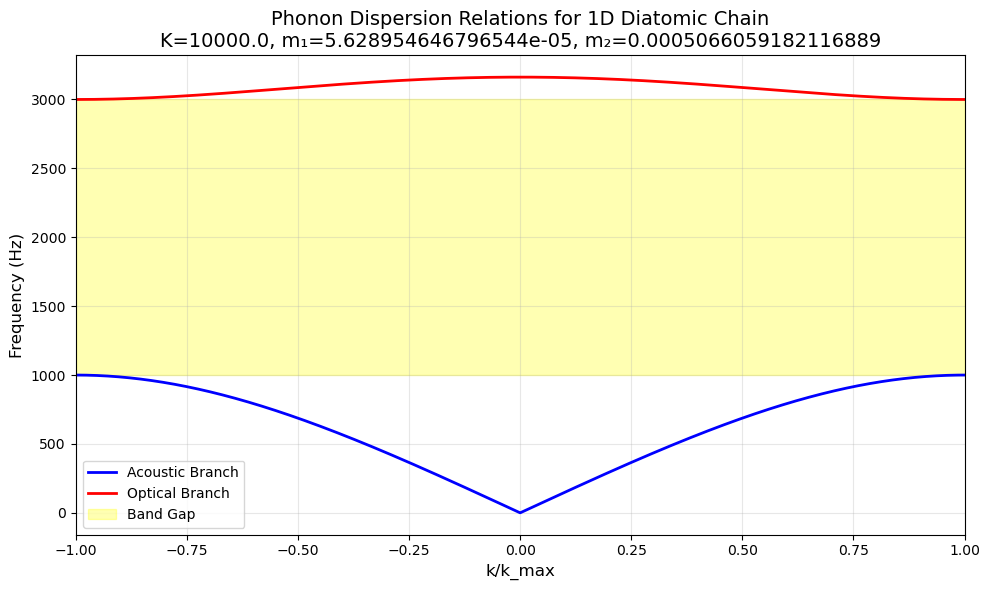


Band Gap:
Bottom Frequency (max acoustic): 1000.00
Top Frequency (min optical):     3000.00
Gap Width:                       2000.00
Mass Ratio (m2/m1):              9.00

Maximum Optical Frequency: 3162.28


In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.fft import rfft, irfft, rfftfreq
from IPython.display import Audio, display

#Frequency gap in the audible frequency range. f- = 1000Hz f+ = 3000 
f_bot = 1000.0  #gap starts
f_top = 3000.0 #gap ends

K = 1.0e4 
omega_bot = 2.0 * np.pi * f_bot  
omega_top = 2.0 * np.pi * f_top   

m2 = 2.0 * K / (omega_bot**2)    
m1 = 2.0 * K / (omega_top**2) 

print(f"{'='*50}")
print(f"K = {K:.3e} N/m")
print(f"m1 = {m1:.6f} kg")
print(f"m2 = {m2:.6f} kg")
print(f"{'='*50}")

#dispersion relation with calculated parameters
plot_dispersion(K,m1,m2)

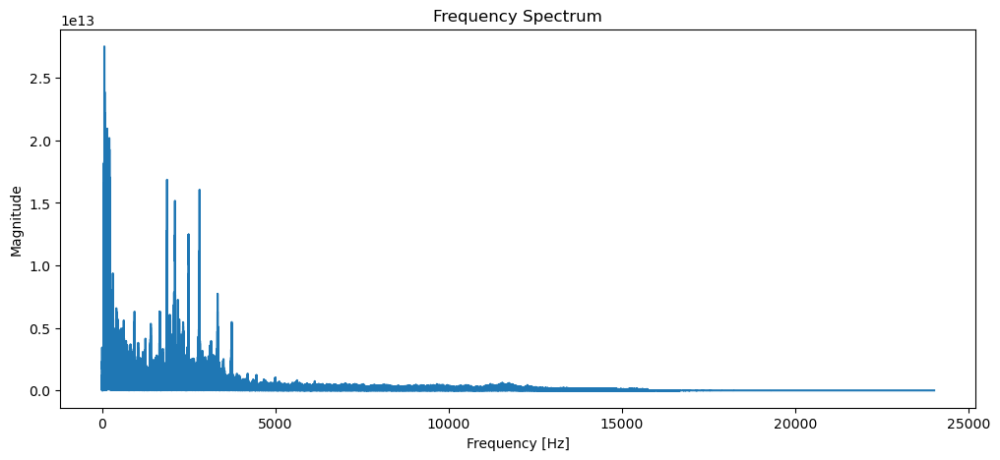

In [39]:
#Take our song through the lattice. 
#Fourier transform to get the frequencies and filter them according to the dispersion relation.

# Load audio file (Herbie Hancock - Chameleon)
sample_rate, data = wavfile.read("chamaleon.wav") 
if data.ndim > 1:
    data = data.mean(axis=1)  # Convert to mono if stereo
data = data.astype(np.float32)

display(Audio(data, rate=sample_rate))


#FFT and frequency plot
N = len(data)
yf = rfft(data)
xf = rfftfreq(N, 1/sample_rate)

plt.figure(figsize=(12,5))
plt.plot(xf, np.abs(yf))
plt.xlabel("Frequency [Hz]")
plt.ylabel("Magnitude")
plt.title("Frequency Spectrum")
plt.show()

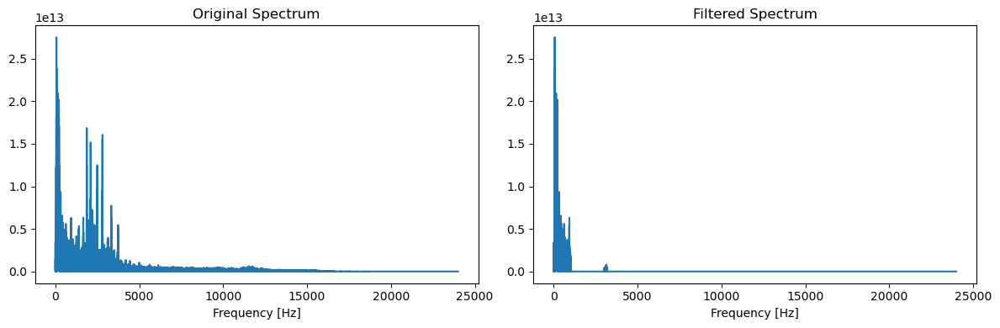

Original Audio:


Filtered Audio:


In [40]:
# filter frequencies and play
def filter_and_play(freq_remove_ranges, freq_damp, damp_factor):
    filtered_yf = np.copy(yf)
    
    # Remove multiple frequency ranges
    for freq_remove in freq_remove_ranges:
        if freq_remove[1] > freq_remove[0]:
            idx = np.where((xf >= freq_remove[0]) & (xf <= freq_remove[1]))
            filtered_yf[idx] = 0
    
    # Dampen
    if freq_damp[1] > freq_damp[0]:
        idx = np.where((xf >= freq_damp[0]) & (xf <= freq_damp[1]))
        filtered_yf[idx] *= damp_factor
    
    # Inverse FFT
    filtered_data = irfft(filtered_yf)
    filtered_data = np.real(filtered_data).astype(np.float32)
    
    # Plot comparison
    plt.figure(figsize=(12,4))
    plt.subplot(1,2,1)
    plt.plot(xf, np.abs(yf))
    plt.title("Original Spectrum")
    plt.xlabel("Frequency [Hz]")
    plt.subplot(1,2,2)
    plt.plot(xf, np.abs(filtered_yf))
    plt.title("Filtered Spectrum")
    plt.xlabel("Frequency [Hz]")
    plt.tight_layout()
    plt.show()
    
    print("Original Audio:")
    display(Audio(data, rate=sample_rate))
    print("Filtered Audio:")
    display(Audio(filtered_data, rate=sample_rate))

#remove band gap and frequencies higher than f_max
freq_remove_ranges = [(1000, 3000), (3162.28, xf.max())]  
#dampen optical branck
freq_damp = (3000, 3162.28)
damp_factor = 0.2

filter_and_play(freq_remove_ranges, freq_damp, damp_factor)

We can observe in the frequency spectra that the frequencies have been transformed as desired. We see the effect of the band-gap blocking completely the frequencies and the damping corresponding to the optical branch.
The sound wave has been transmitted through our lattice, most higher frequencies have been blocked and the low frequencies now dominate. Thanks to the vibrational properties of the diatomic crystal structures, now we can enjoy the magnificent bassline of this song much better. 